In [2]:
import numpy as np
import cv2
from pathlib import Path
from scipy.spatial import cKDTree
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

from descriptor_index_pb2 import DescriptorIndex
from debug_fusion_pb2 import DebugFusion
from utils import plot_imgs
%load_ext autoreload
%autoreload 2

INDEX_ROOT = '../deep-relocalization/data/'
MAP_ROOT = '../deep-relocalization/maps/'

In [3]:
def get_index(name):
    index = DescriptorIndex()
    with open(Path(INDEX_ROOT, name).as_posix(), 'rb') as f:
        index.ParseFromString(f.read())
    return index
def get_debug_data(name):
    debug = DebugFusion()
    with open(Path(INDEX_ROOT, 'loc_debug', name).as_posix(), 'rb') as f:
        debug.ParseFromString(f.read())
    return debug
def get_data_from_index(index):
    positions = np.stack([f.position_vector.data for f in index.frames])
    rotations = np.stack([np.reshape(f.rotation_matrix.data, (3, 3), order='C') for f in index.frames])
    descriptors = np.stack([f.global_descriptor.data for f in index.frames])
    resources = np.stack([f.resource_name for f in index.frames])
    ids = [f.vertex_id for f in index.frames]
    return {'pos': positions, 'rot': rotations, 'descriptors': descriptors, 'res': resources, 'ids': ids}
def get_image(index, i):
    Path(MAP_ROOT, index.data_name, 'resources/raw_images/')
    return cv2.imread(
        Path(MAP_ROOT, index.data_name, 'resources/raw_images/', '%s.pgm' % index.frames[i].resource_name).as_posix())

In [4]:
ref_file = 'lindenhof_afternoon_aligned_model-nopca.pb'
query_file = 'lindenhof_wet_aligned_model-nopca.pb'

In [5]:
ref_index = get_index(ref_file)
query_index = get_index(query_file)
ref_data = get_data_from_index(ref_index)
query_data = get_data_from_index(query_index)

In [11]:
debug_data = get_debug_data('fusion_debug_sift-kdtree-lowe_scale-5-6_dim-128_matches-wrong.pb')
ok_queries = [q for q in debug_data.query_components if q.status in ['ok', 'wrong']]
fail_queries = [q for q in debug_data.query_components if q.status == 'fail']
wrong_queries = [q for q in debug_data.query_components if q.status == 'wrong']

# Size of the clusters containing ground truth matches

- Blue: successful queries
- Orange: failed queries

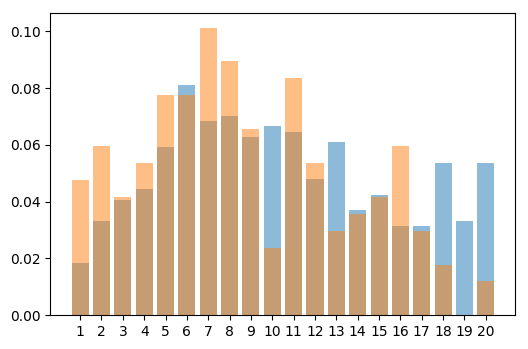

In [9]:
len_ok = [len(q.retrieved_ids) for q in ok_queries]
len_fail = [len(q.retrieved_ids) for q in fail_queries]
plt.figure(dpi=100)
plt.bar(*(lambda i, c: (i, c/np.sum(c)))(*np.unique(len_ok, return_counts=True)), alpha=0.5);
plt.bar(*(lambda i, c: (i, c/np.sum(c)))(*np.unique(len_fail, return_counts=True)), alpha=0.5);
plt.xticks(list(set(np.unique(len_ok)) or set(np.unique(len_fail))));

# Number of descriptor matches in the ground truth clusters

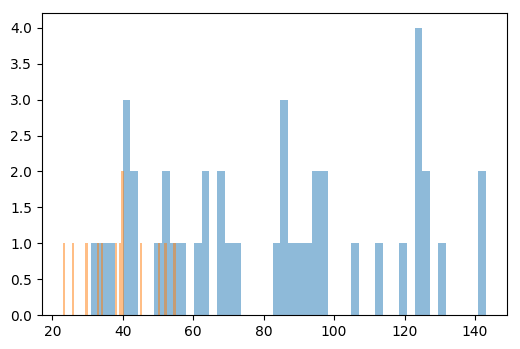

In [97]:
plt.figure(dpi=100)
plt.hist([q.num_matches for q in ok_queries], alpha=0.5, bins=50);
plt.hist([q.num_matches for q in fail_queries], alpha=0.5, bins=50);

# Number of inlier matches in the ground truth clusters

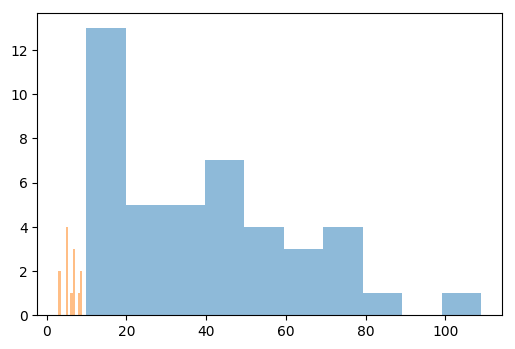

In [98]:
plt.figure(dpi=100)
plt.hist([q.num_inliers for q in ok_queries], alpha=0.5);
plt.hist([q.num_inliers for q in fail_queries], alpha=0.5);

# Number of inlier matches in the queries failing because of too few inliers

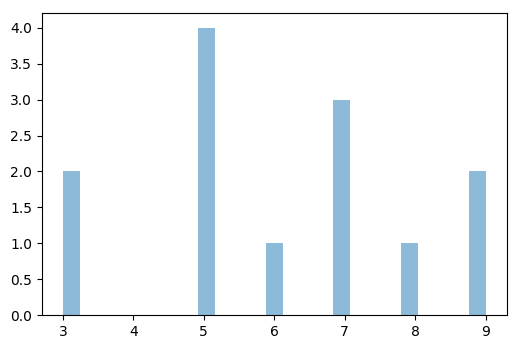

In [99]:
plt.figure(dpi=100)
plt.hist([q.num_inliers for q in fail_queries if q.inlier_ratio < 0], alpha=0.5, bins=25);

# Inlier ratios in the ground truth clusters (when enough inliers)

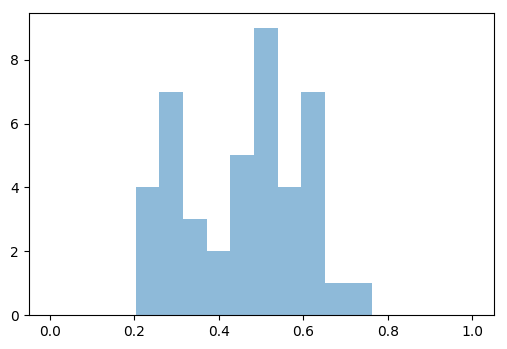

In [100]:
plt.figure(dpi=100)
plt.hist([q.inlier_ratio for q in ok_queries], alpha=0.5);
plt.hist([q.inlier_ratio for q in fail_queries if q.inlier_ratio >= 0], alpha=0.5);

# Sucessful queries

- First column: query image
- Subsequent columns: some of the retrieved images in the same cluster
- Numbers on the left: `number of frames in the cluster : number of matches : number of inliers : inlier ratio`

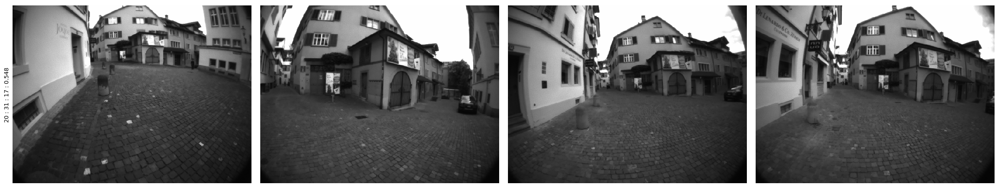

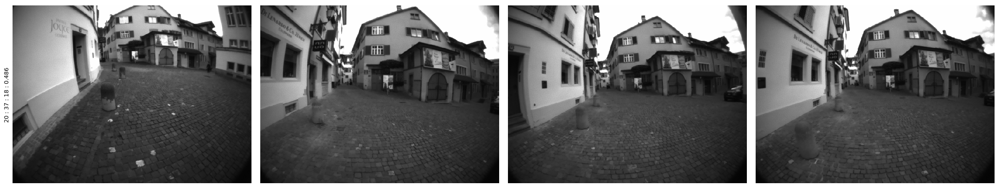

In [101]:
for i, q in zip(range(2), ok_queries):
    query_im = get_image(query_index, query_data['ids'].index(q.query_id))
    retrieved_indices = [ref_data['ids'].index(vertex_id) for vertex_id in q.retrieved_ids]
    retrieved_imgs = [get_image(ref_index, r) for r in retrieved_indices]
    ylabel = '{} : {} : {} : {:.3f}'.format(
        len(q.retrieved_ids), q.num_matches, q.num_inliers, q.inlier_ratio)
    plot_imgs([query_im] + retrieved_imgs[:3], ylabel=ylabel)

# Failing queries

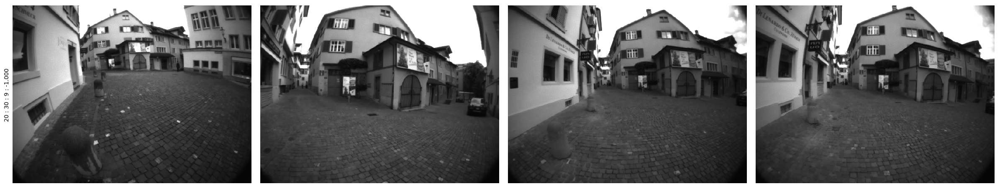

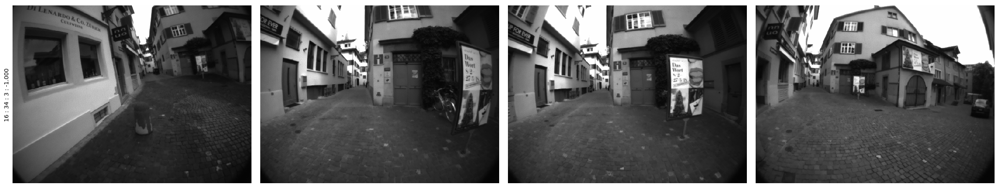

In [102]:
for i in range(2):
    q = fail_queries[i]
    query_im = get_image(query_index, query_data['ids'].index(q.query_id))
    retrieved_indices = [ref_data['ids'].index(vertex_id) for vertex_id in q.retrieved_ids]
    retrieved_imgs = [get_image(ref_index, r) for r in retrieved_indices]
    ylabel = '{} : {} : {} : {:.3f}'.format(
        len(q.retrieved_ids), q.num_matches, q.num_inliers, q.inlier_ratio)
    plot_imgs([query_im] + retrieved_imgs[:3], ylabel=ylabel)

# Matches

In [15]:
def meas2kp(meas):
    return cv2.KeyPoint(meas.data[0], meas.data[1], 1)

In [ ]:
q = wrong_queries[50]
query_im = get_image(query_index, query_data['ids'].index(q.query_id))
matches = [[] for _ in range(len(q.retrieved_ids))]
for m in q.matches:
    matches[q.retrieved_ids[:].index(m.db_vertex_id)].append(m)
ids_matches = sorted(zip(q.retrieved_ids[:], matches), key=lambda i: len(i[1]), reverse=True)
query_im = get_image(query_index, query_data['ids'].index(q.query_id))
#print(matches)
print('Num matches: {}'.format([len(m[1]) for m in ids_matches]))
print('Num inliers: {}'.format(q.num_inliers))
for _, (retrieved_id, matches) in zip(range(3), ids_matches):
    retrieved_im = get_image(ref_index, ref_data['ids'].index(retrieved_id))
    query_kps = [meas2kp(m.query_measurement) for m in matches]
    retrieved_kps = [meas2kp(m.db_measurement) for m in matches]
    cv_matches = [cv2.DMatch(i, i, 1) for i in range(len(matches))]
    disp_im = cv2.drawMatches(query_im, query_kps, retrieved_im, retrieved_kps, cv_matches, None)
    plot_imgs([disp_im], dpi=200)

In [49]:
err=query_data['pos'][query_data['ids'].index(q.query_id)] - ref_data['pos'][ref_data['ids'].index(ids_matches[0][0])]
print(err, np.linalg.norm(err))

[ 0.21088976 -4.15255484 -0.70679703] 4.217552393574759


Num matches: [41, 19, 13, 12, 1]
Num inliers: 34


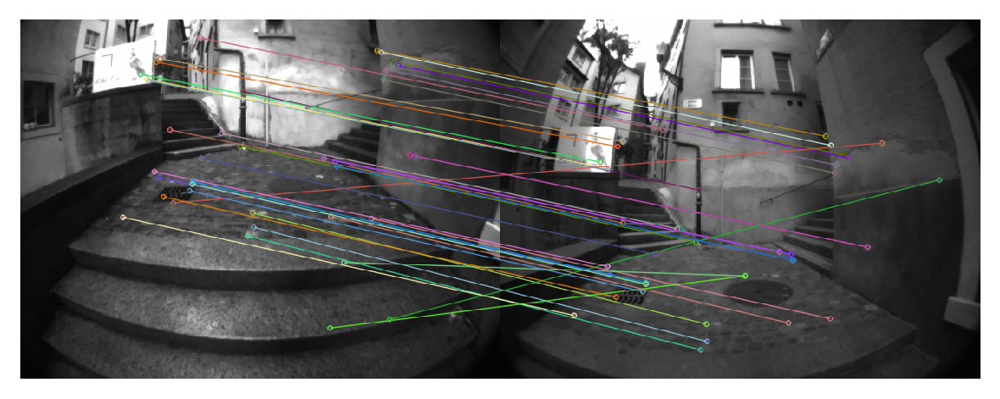

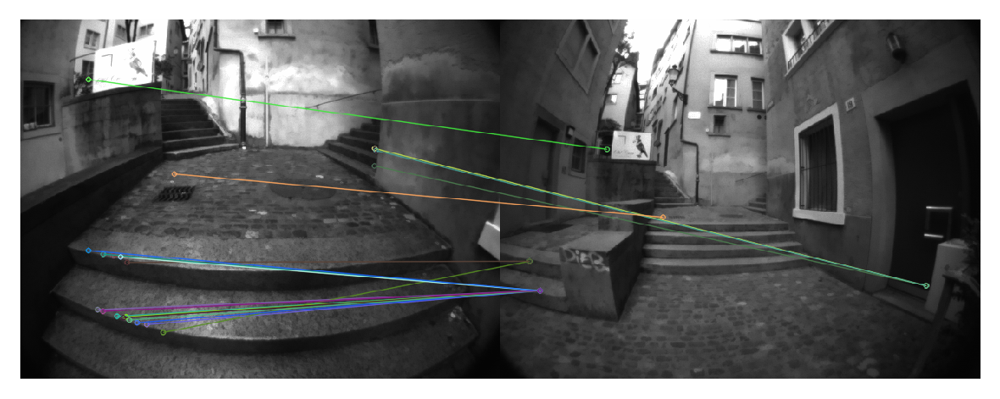

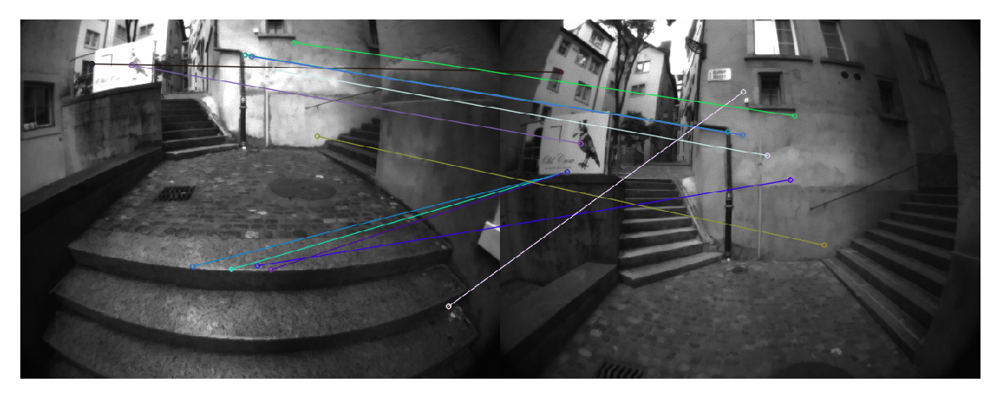

In [47]:
err=query_data['pos'][query_data['ids'].index(q.query_id)] - ref_data['pos'][ref_data['ids'].index(ids_matches[0][0])]
print(err, np.linalg.norm(err))

[-0.97829093  3.99881235  0.6456271 ] 4.167059834057727


Num matches: [32, 15, 11, 10, 3, 2]
Num inliers: 48


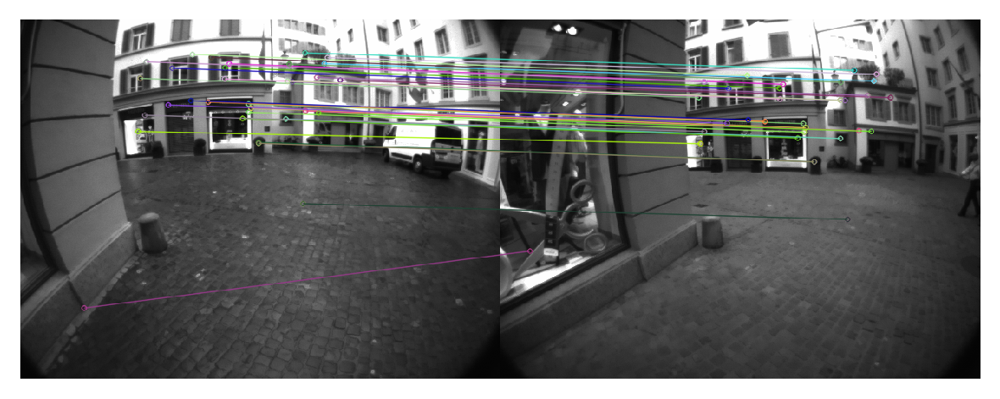

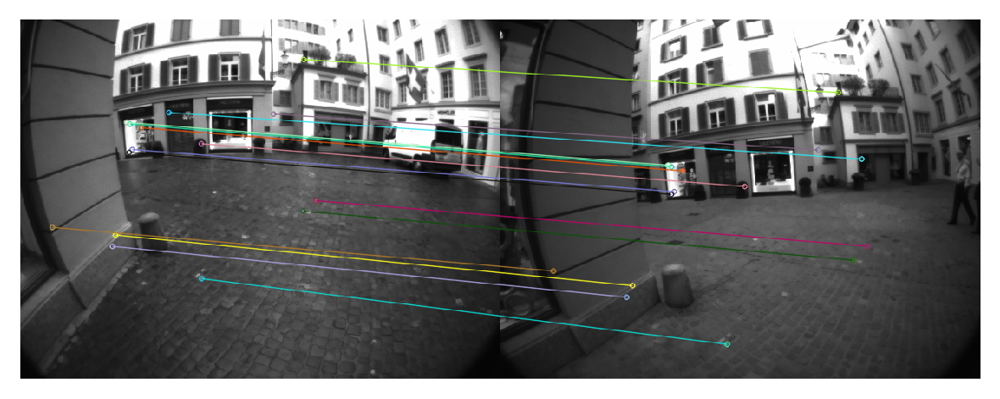

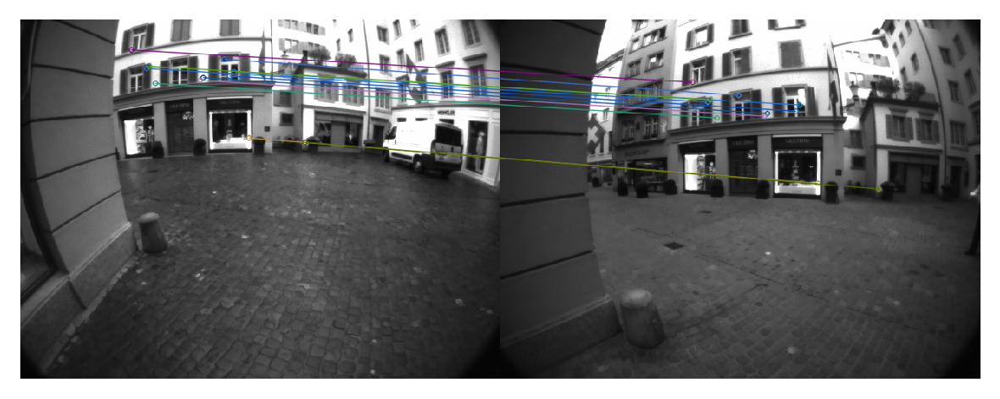

# SIFT - labeled as wrong relocalization

# SIFT - kd-tree, Lowe ratio test, scale=5.6 - failure

Num matches: [19, 9, 6, 6, 5, 3, 3, 1, 0]
Num inliers: 7


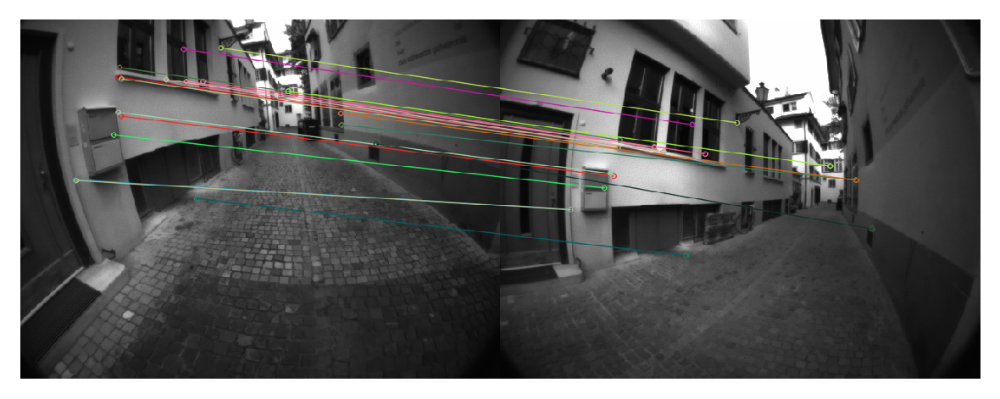

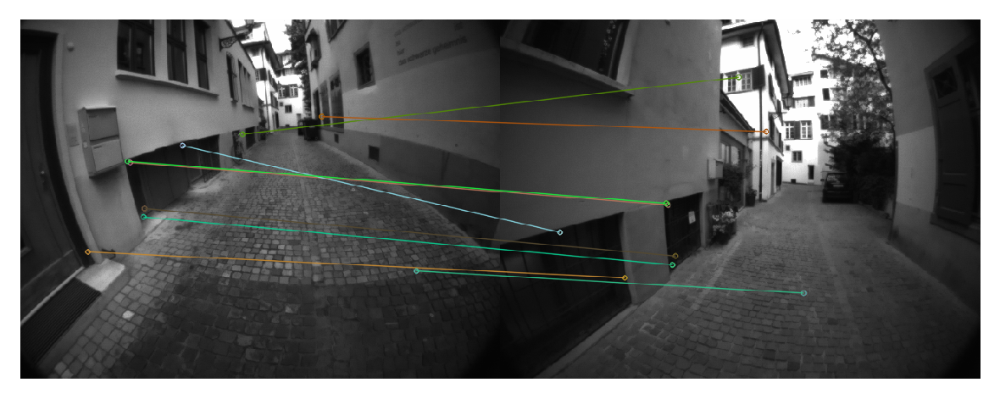

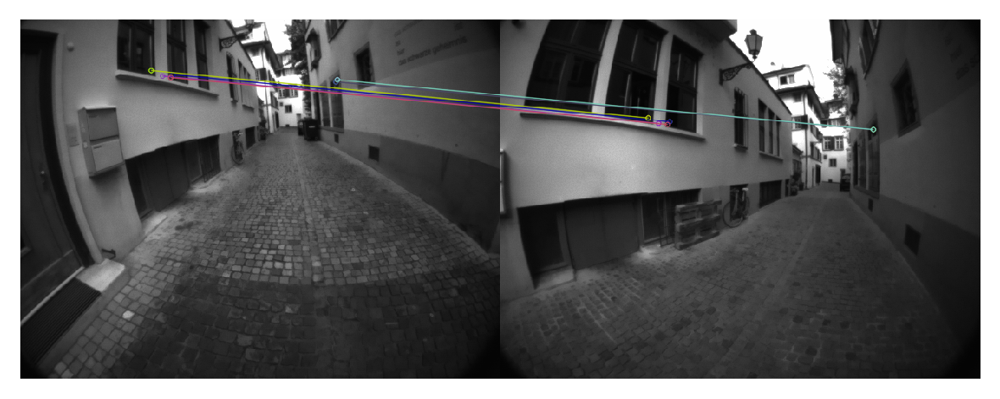

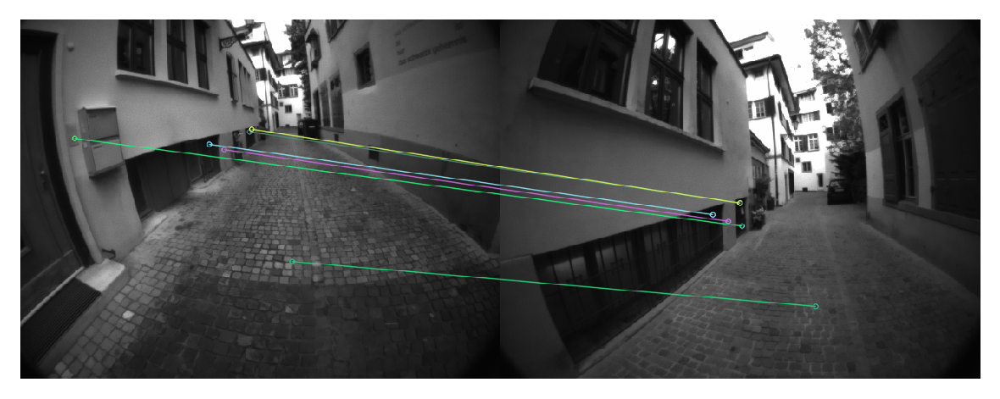

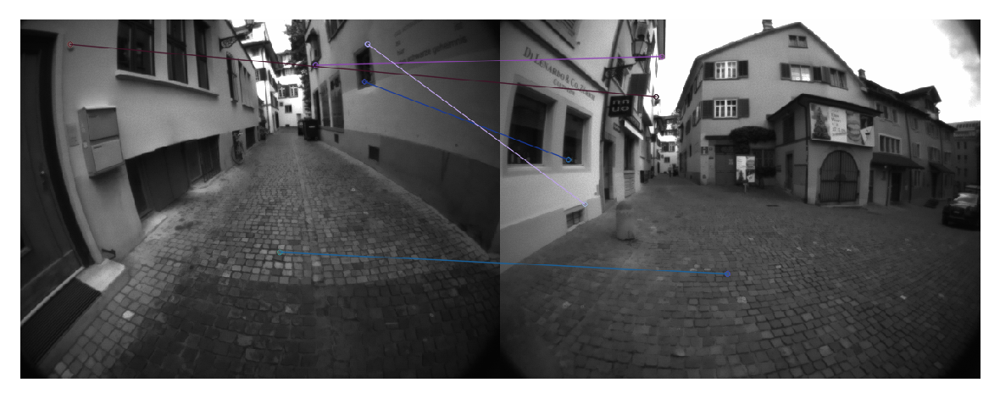

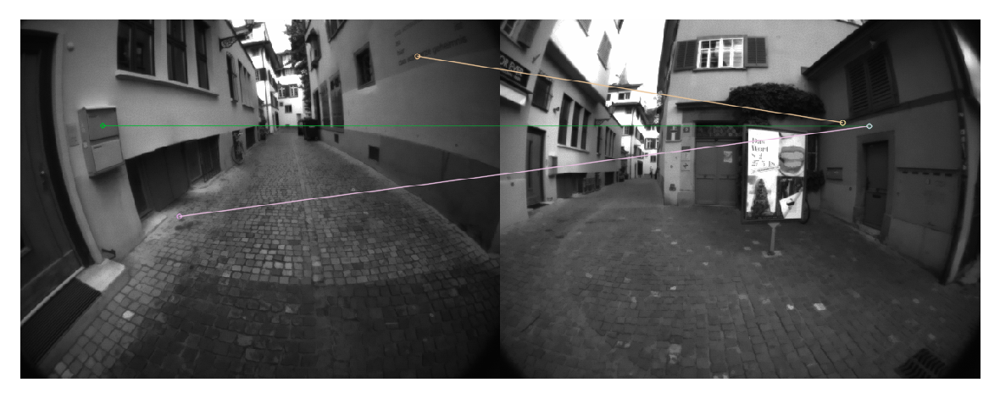

# SIFT - kd-tree, Lowe ratio test, scale=5.6 - success

Num matches: [10, 8, 7, 7, 5, 5, 5, 3, 2, 1, 1]
Num inliers: 11


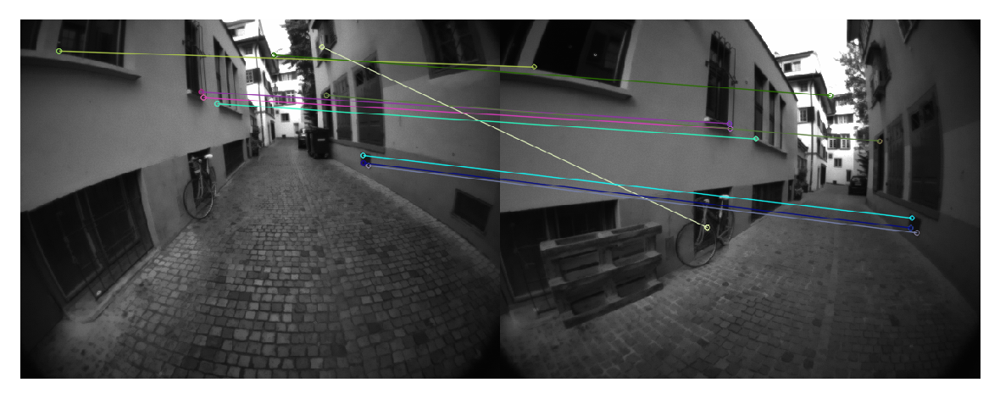

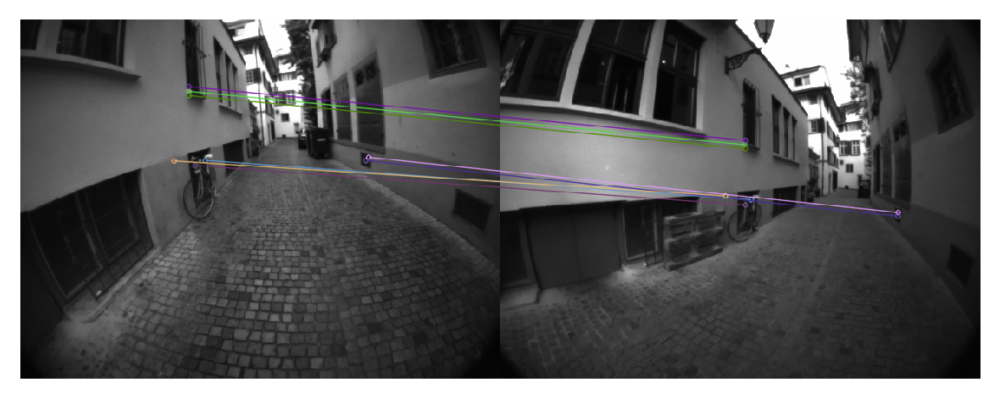

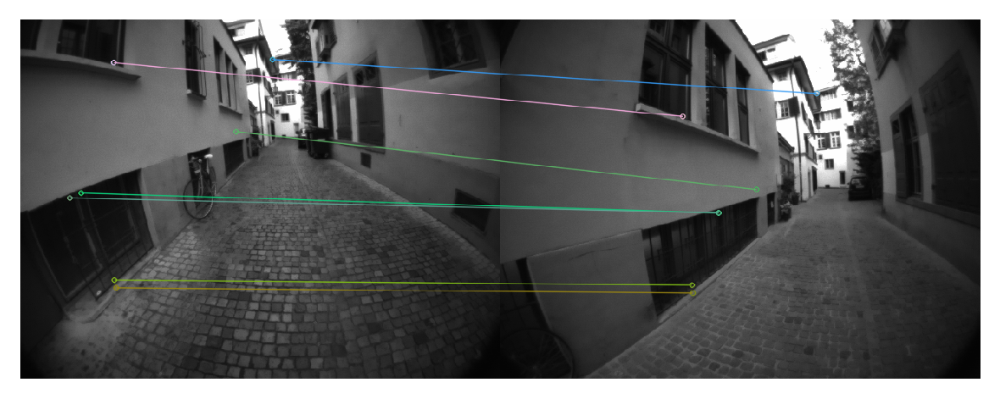

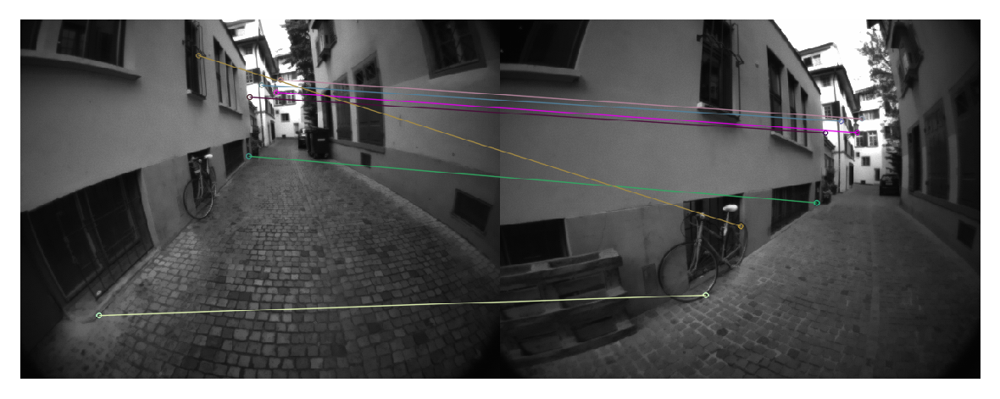

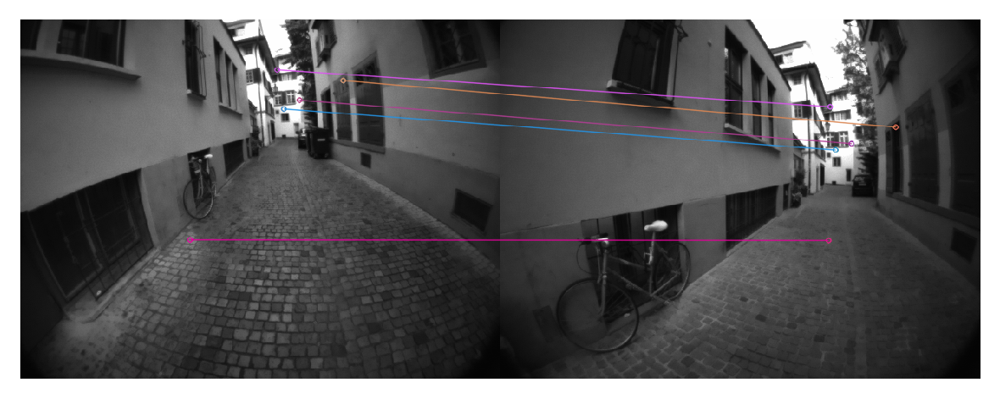

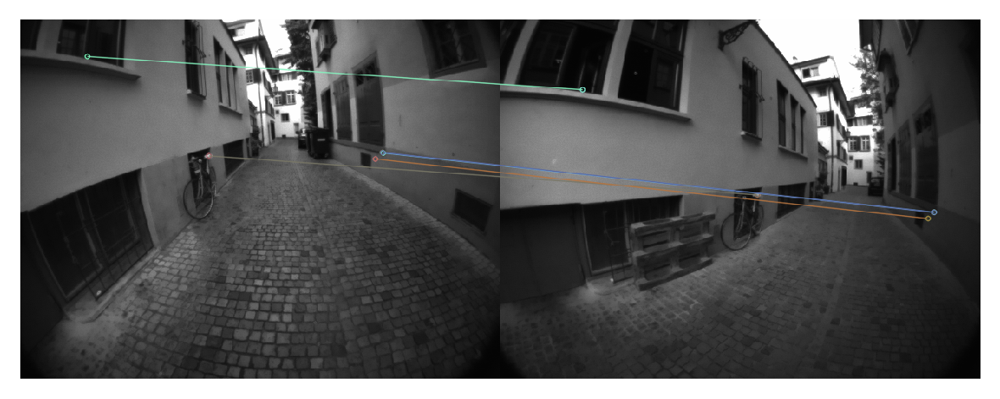

# Binary descriptors - matching without any prior - success

Num matches: [11, 10, 8, 8, 7, 7, 5, 3, 3]
Num inliers: 35


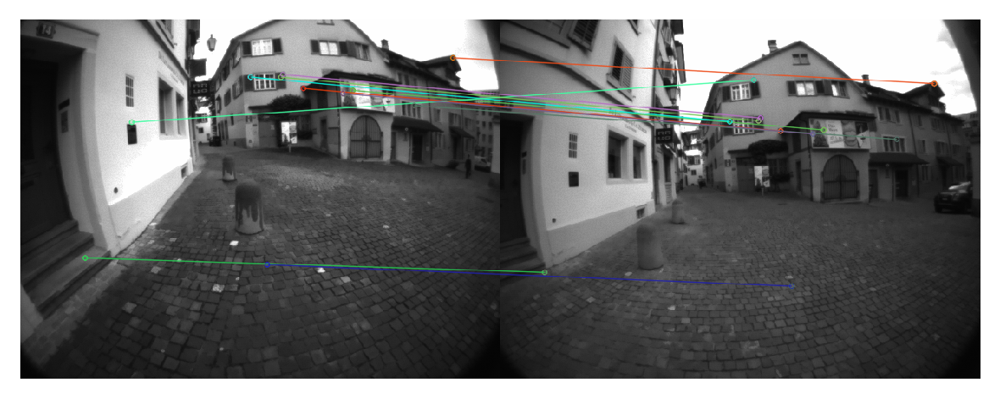

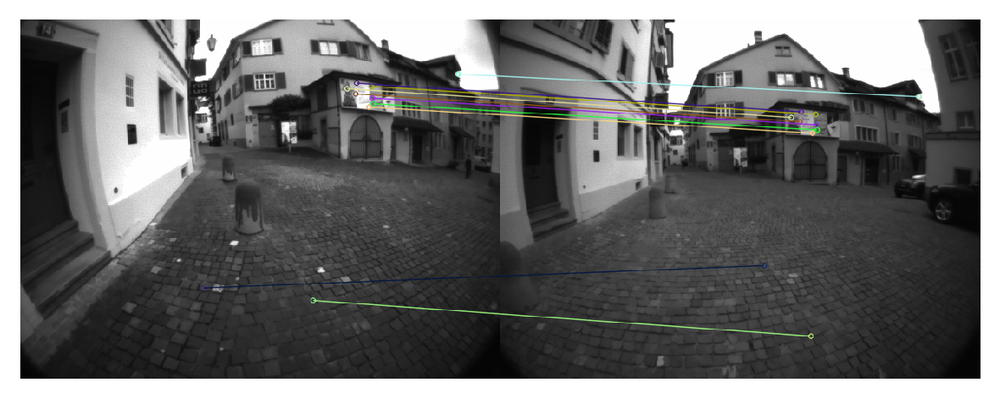

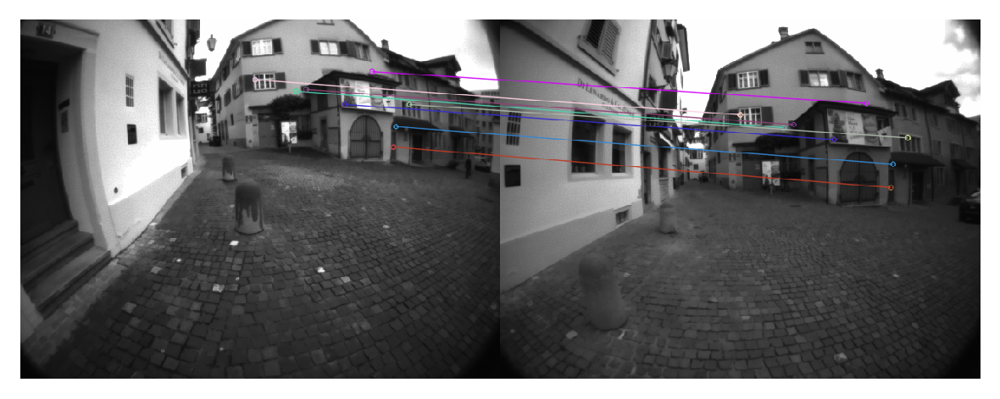

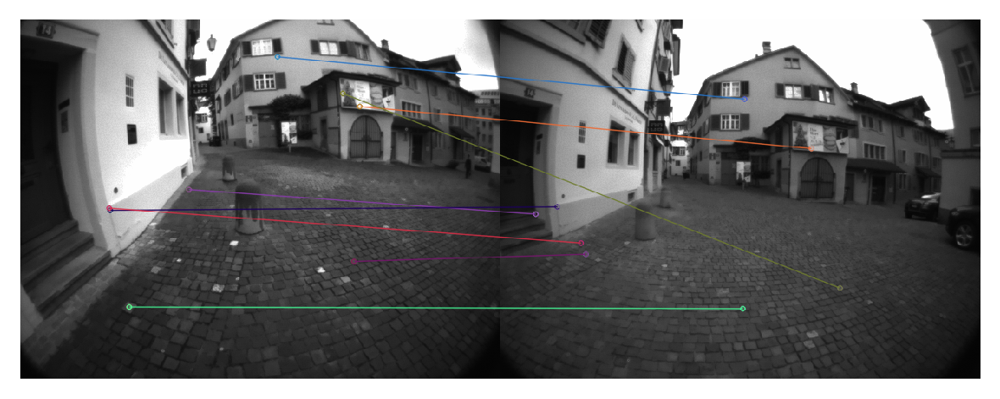

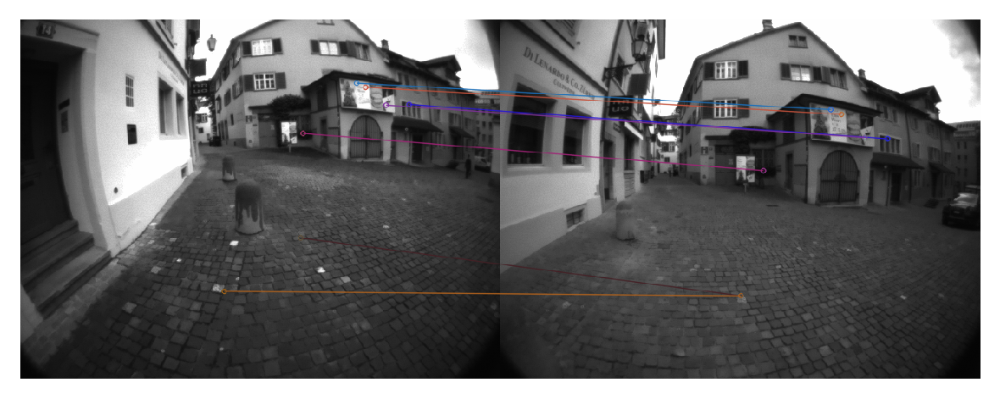

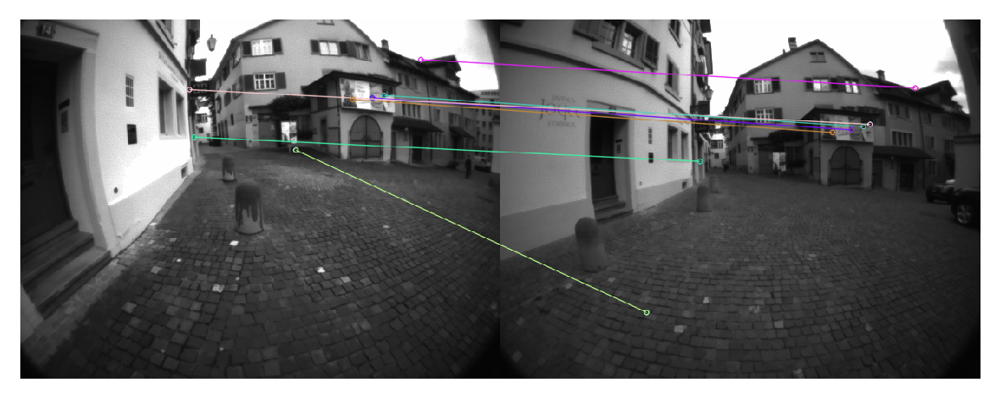

# Binary descriptors - inverted multi-index no-covis - fail

Num matches: [19, 19, 18, 17, 17, 13, 12, 11, 9, 6, 6, 6, 5]
Num inliers: 3


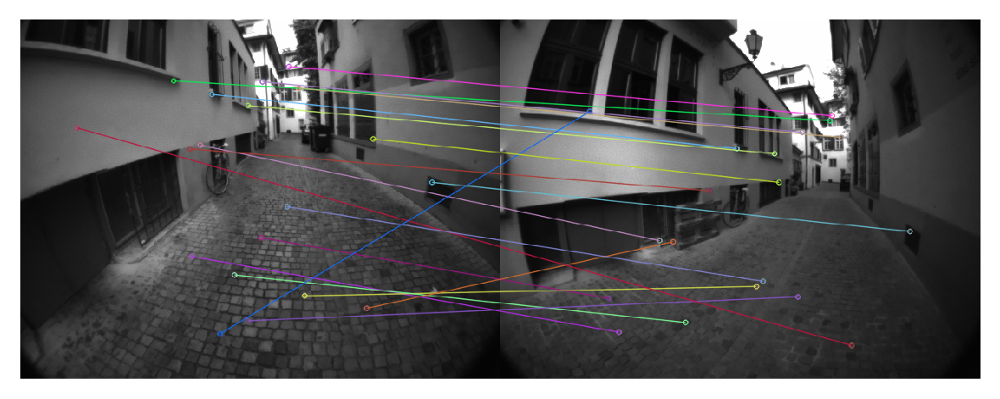

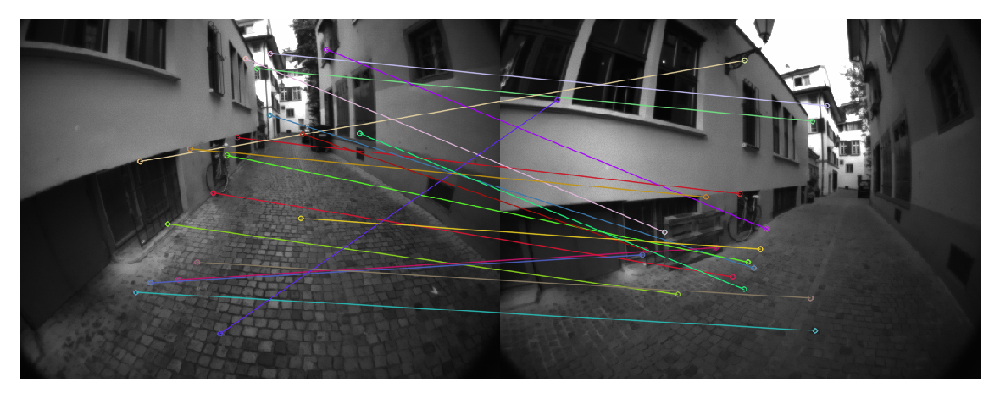

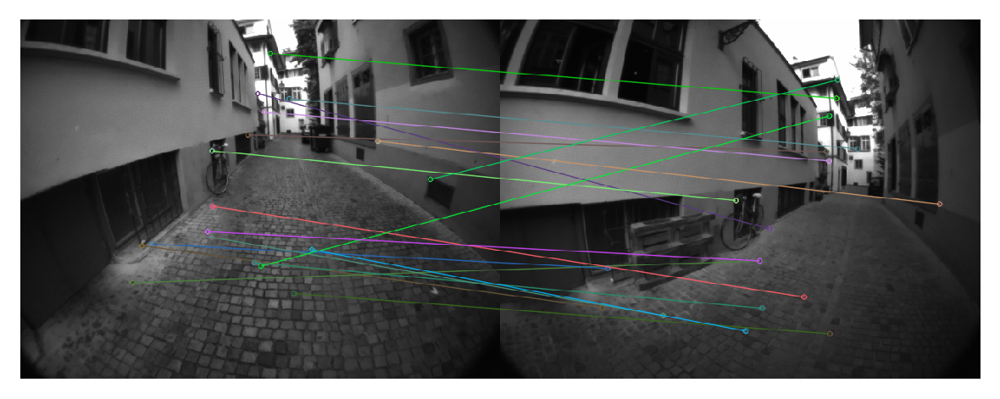

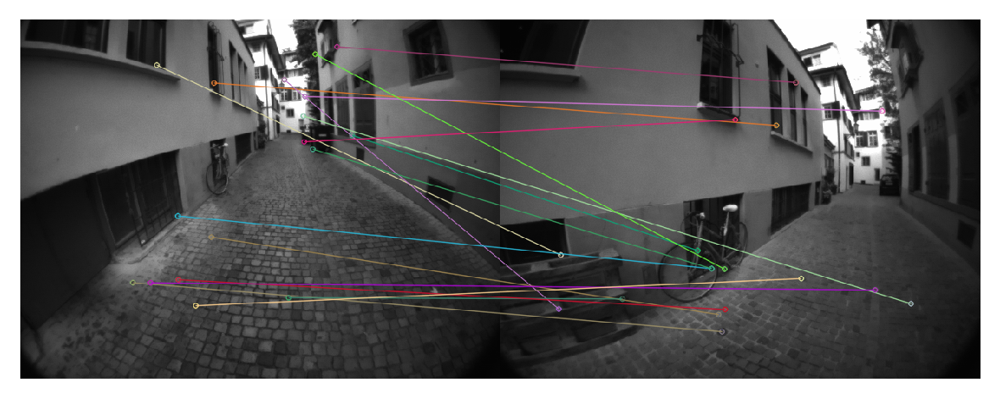

Num matches: [27, 17, 16, 16, 14, 13, 11, 10, 9, 8, 8, 8, 7]
Num inliers: 4


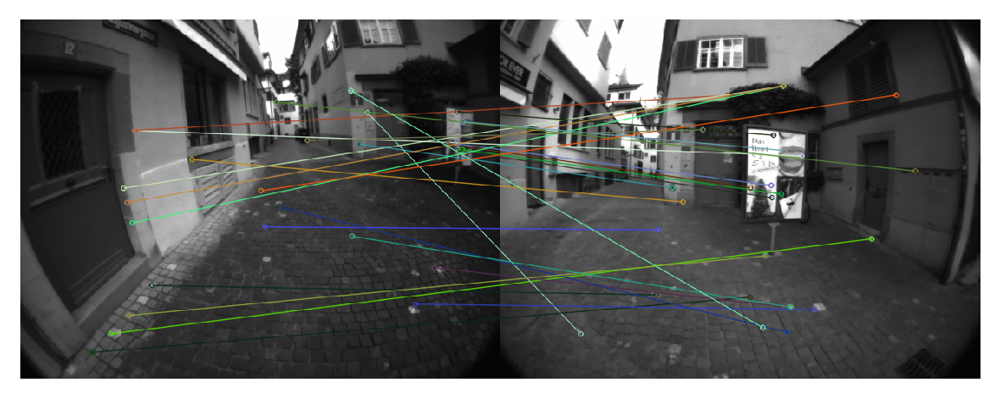

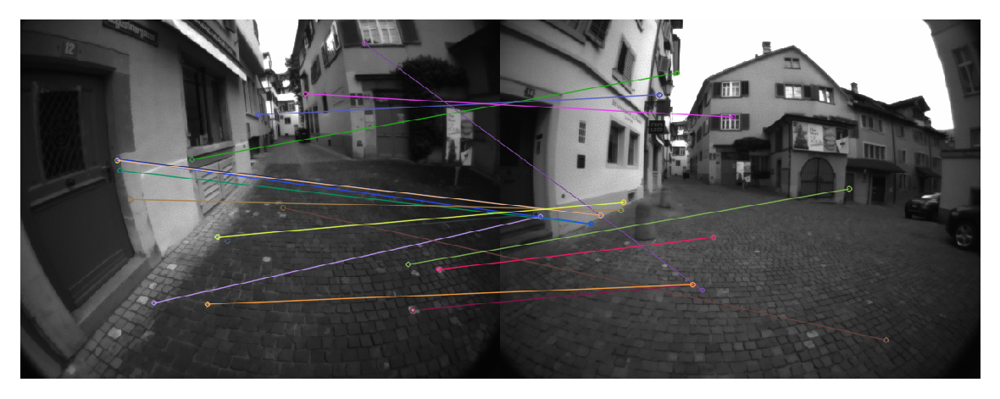

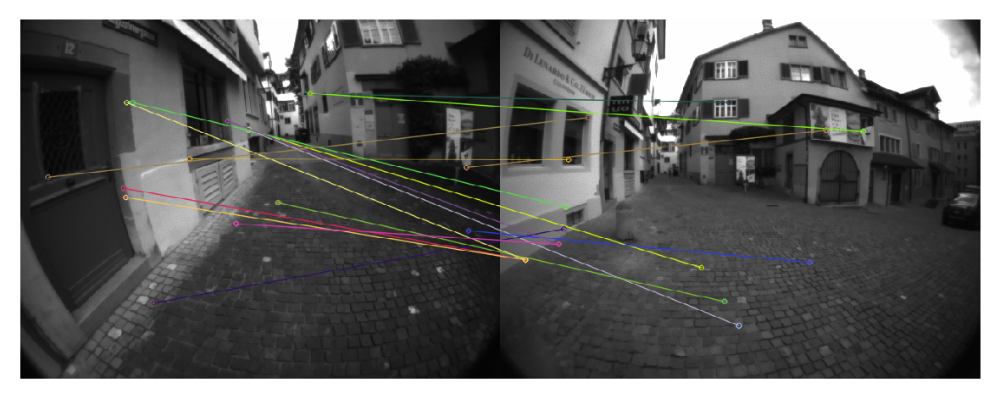

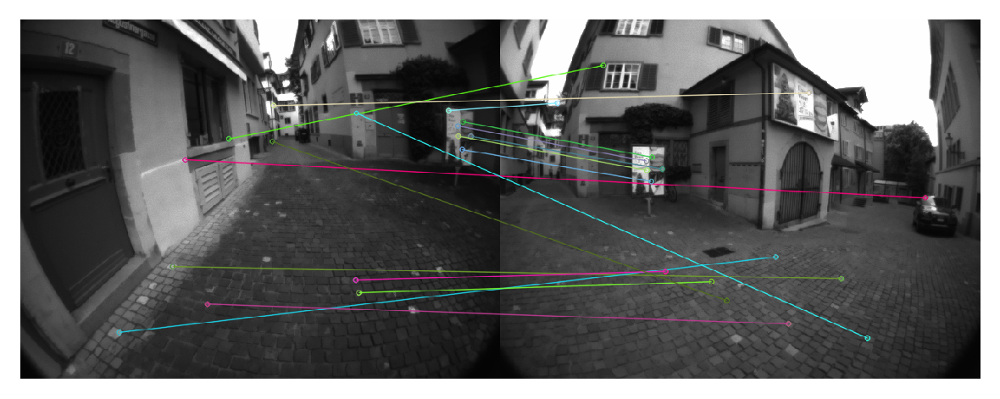

# Binary descriptors - inverted multi-index - fail

Num matches: [15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Num inliers: 4


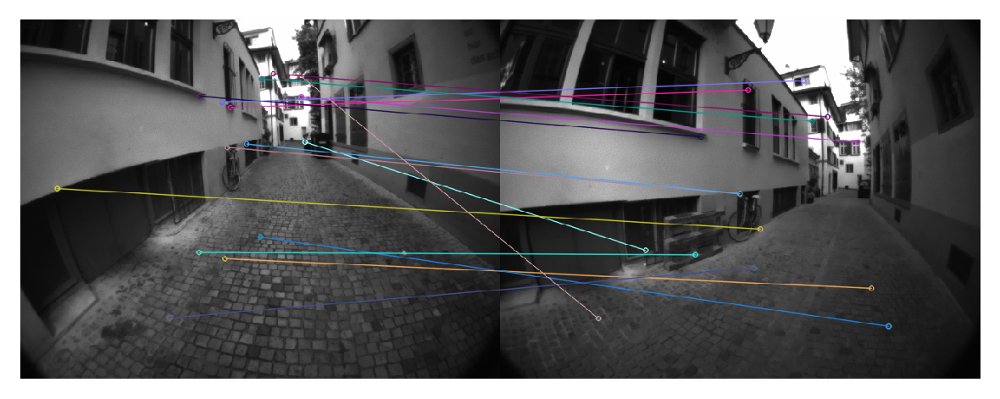

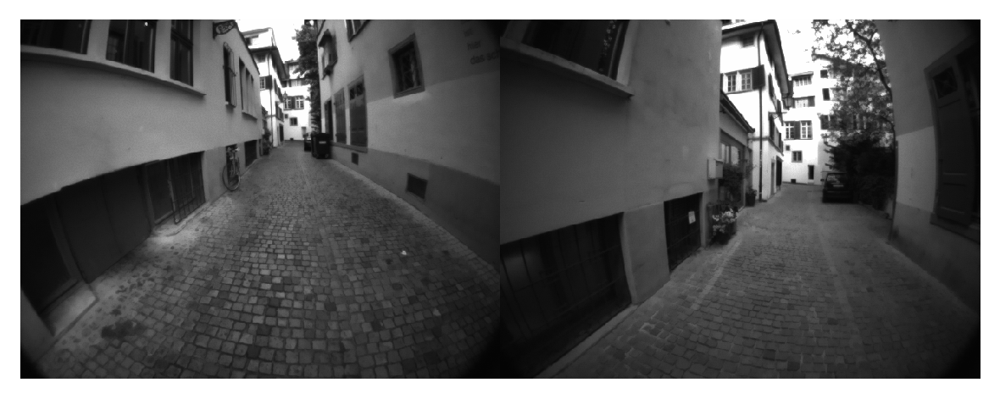

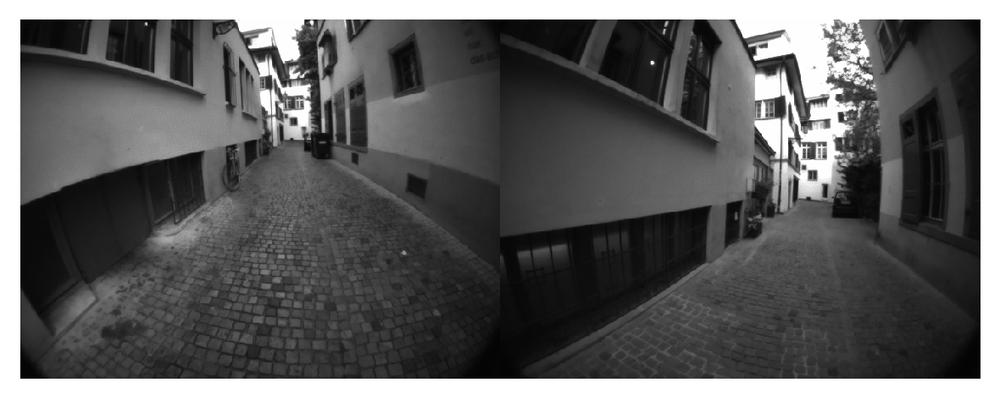

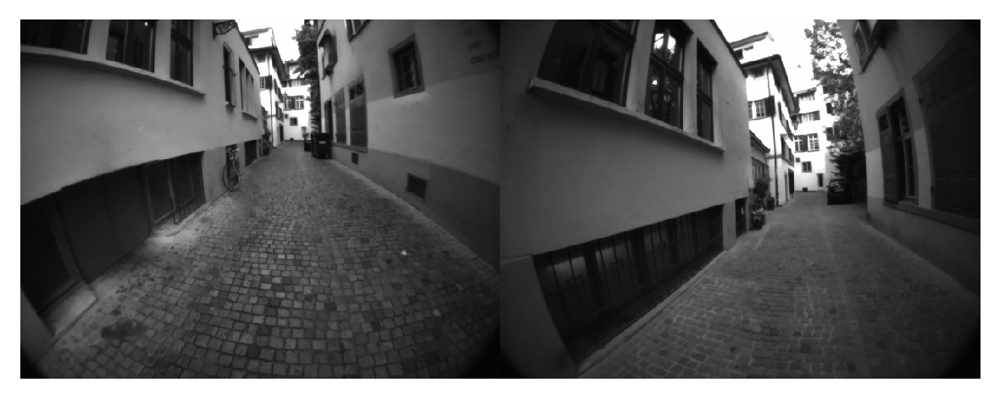

Num matches: [17, 14, 13, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Num inliers: 5


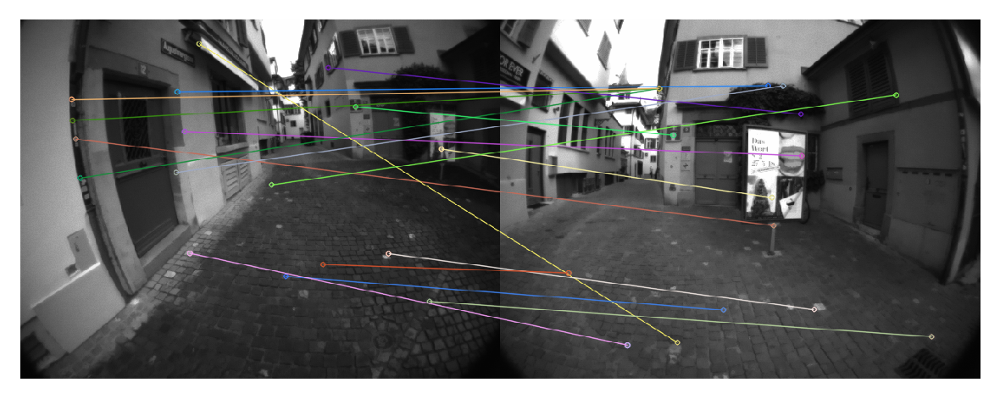

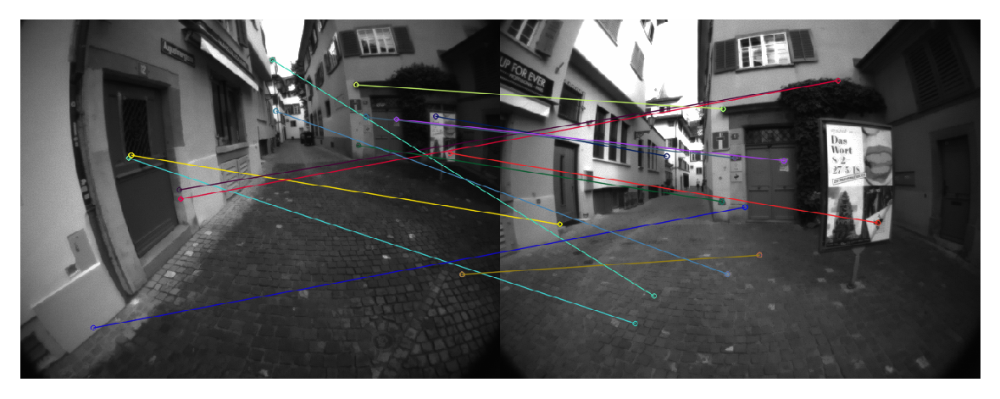

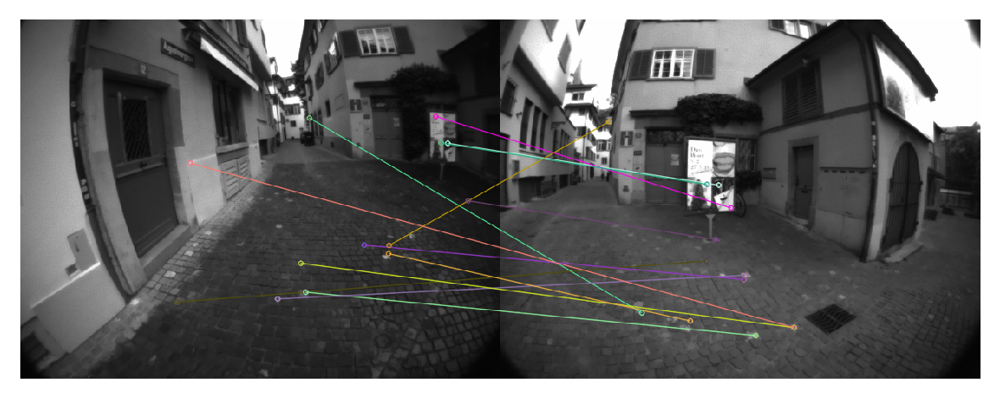

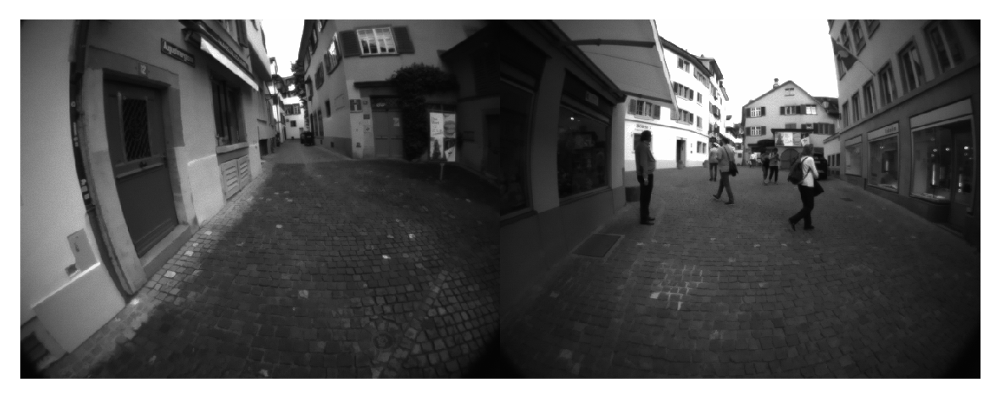

Num matches: [15, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Num inliers: 3


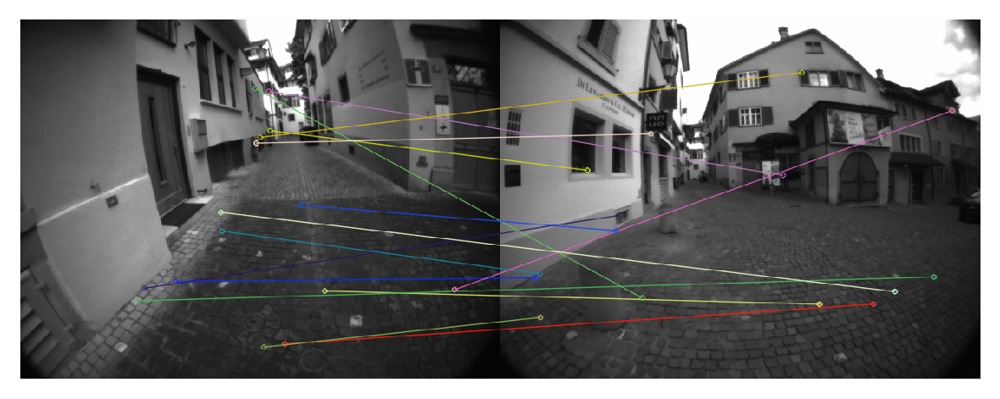

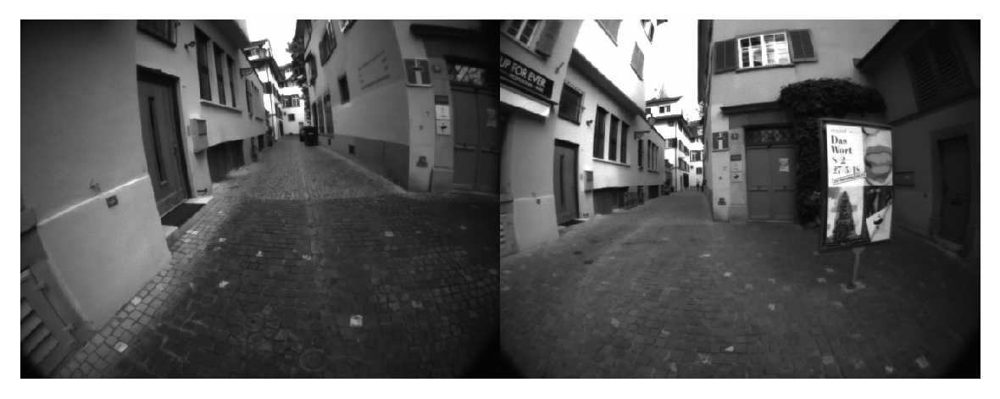

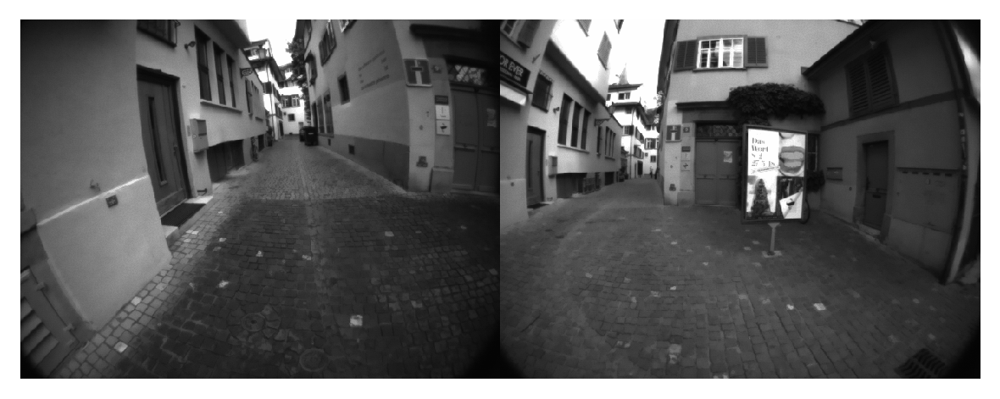

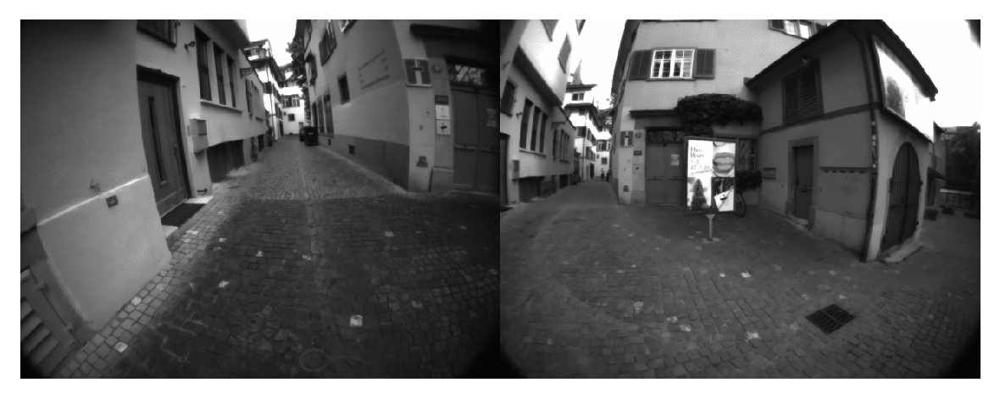

Num matches: [17, 15, 15, 13, 11, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Num inliers: 4


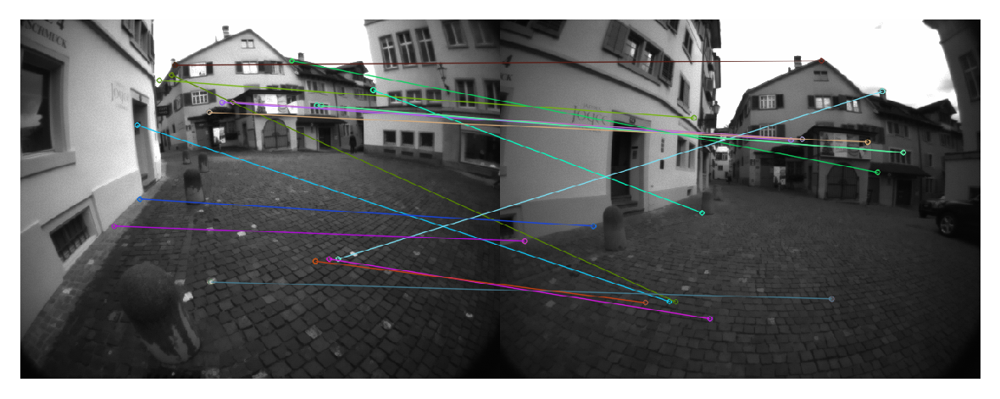

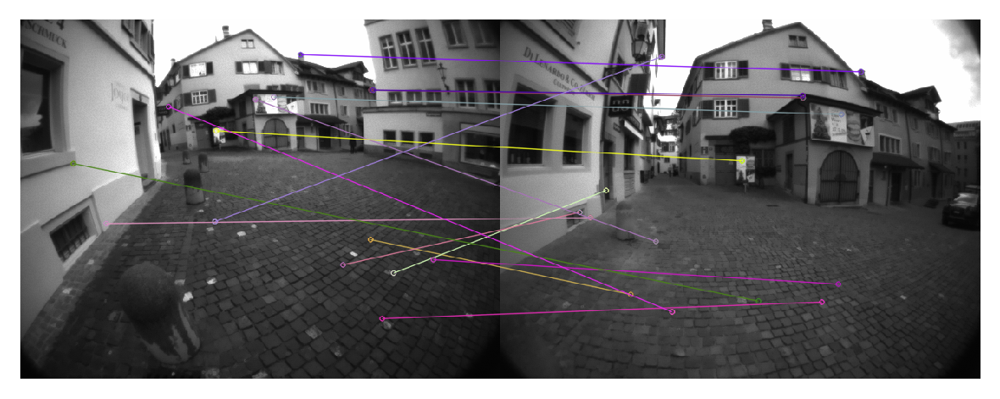

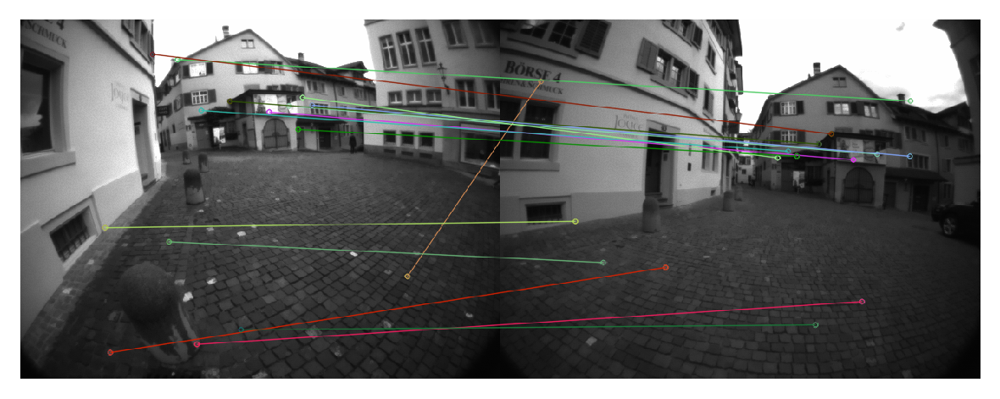

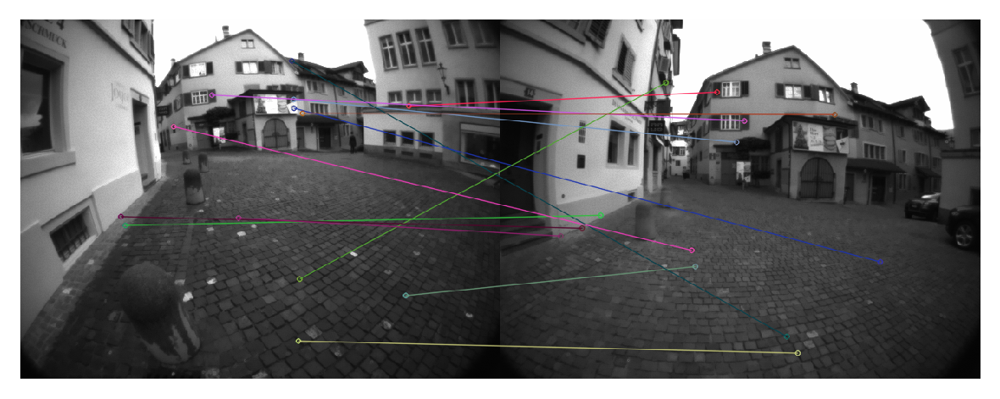

# Binary descriptors - inverted multi-index - success

Num matches: [22, 18, 17, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
Num inliers: 12


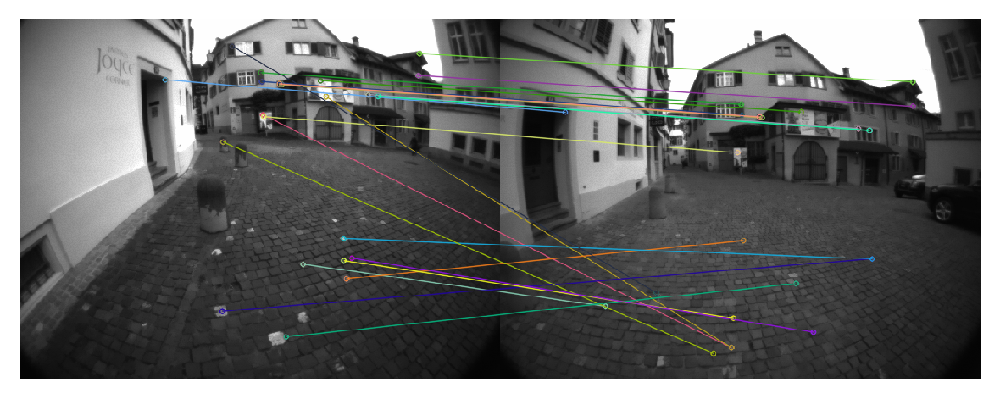

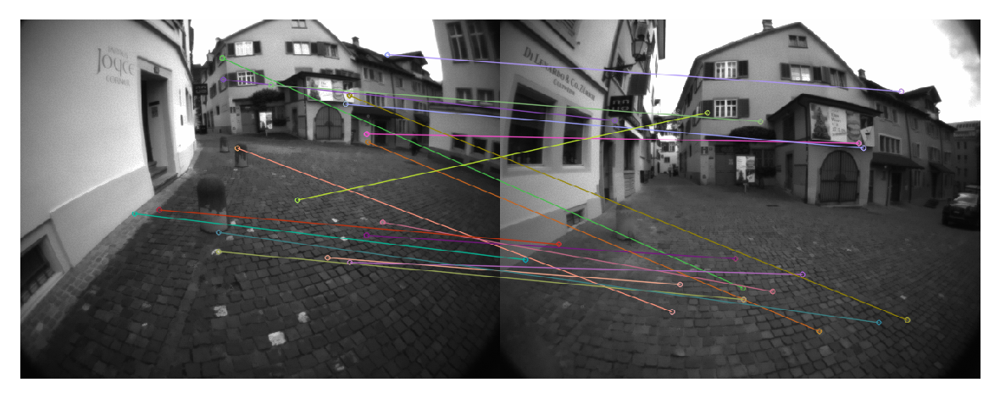

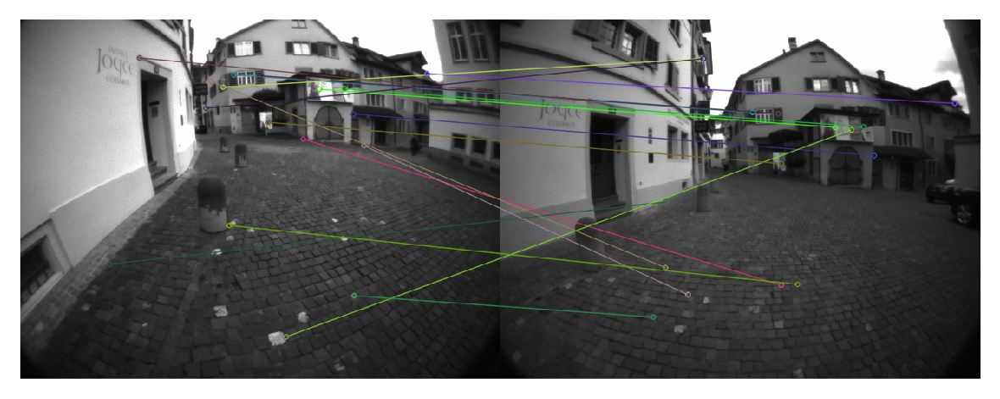

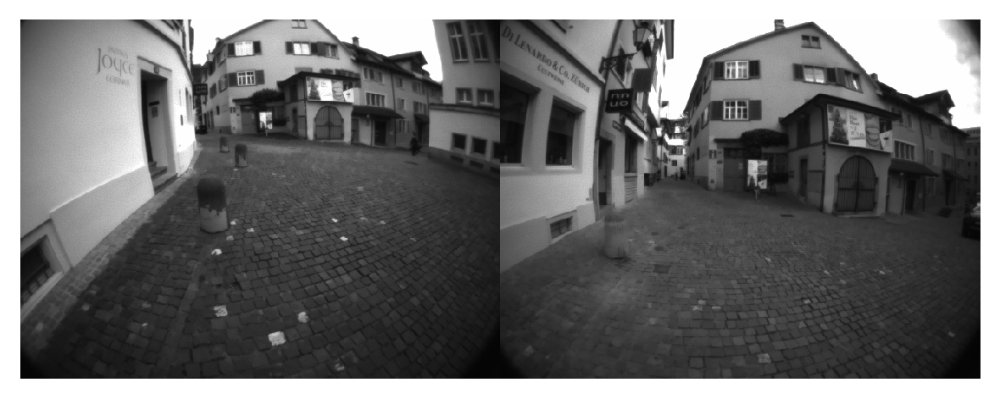

# Sanity-check with the OpenCV matching pipeline

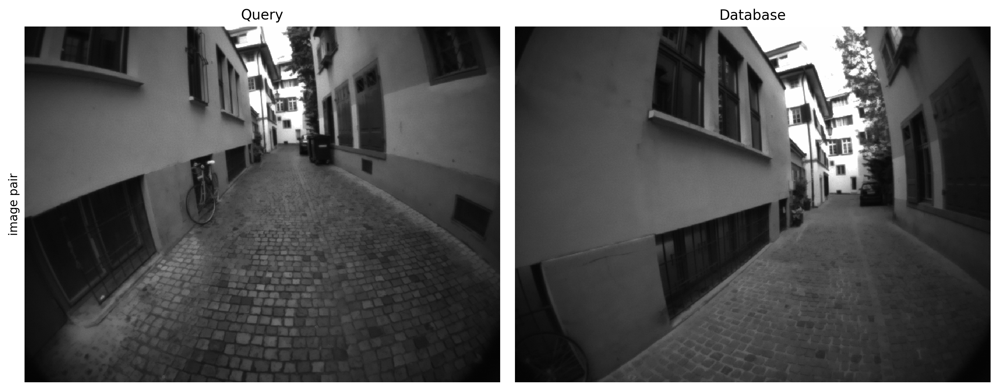

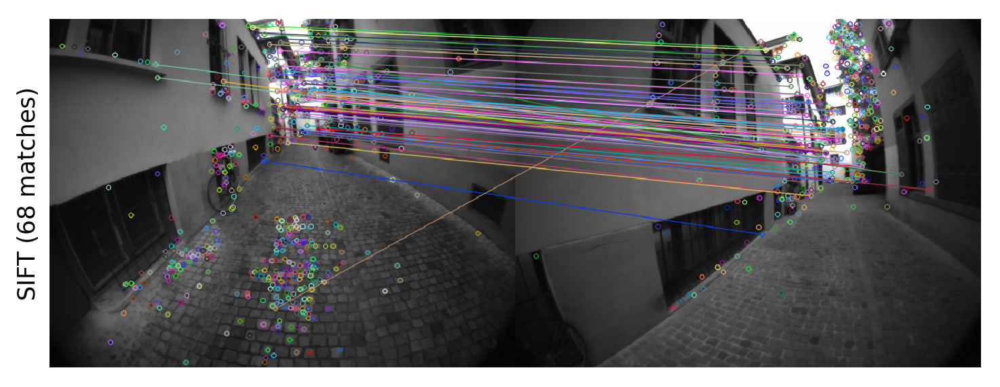

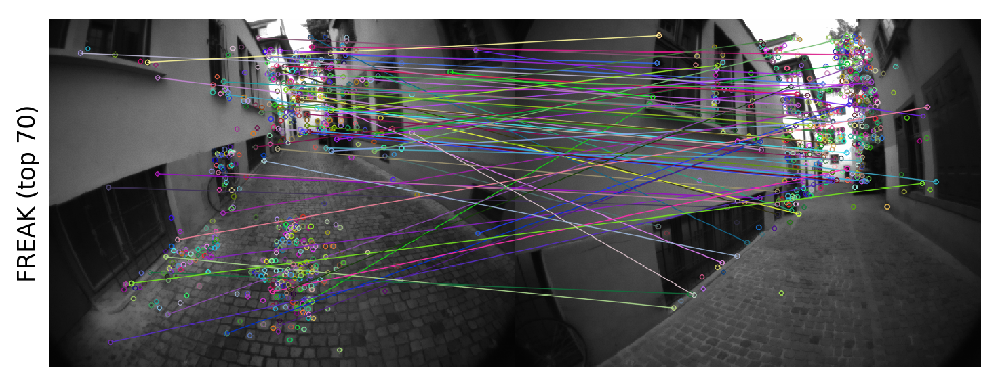

In [84]:
q = fail_queries[25]
query_im = get_image(query_index, query_data['ids'].index(q.query_id))
retrieved_im = get_image(ref_index, ref_data['ids'].index(q.retrieved_ids[0]))
plot_imgs([query_im, retrieved_im], dpi=250, ylabel='image pair', titles=['Query', 'Database'])

sift = cv2.xfeatures2d.SIFT_create(nOctaveLayers=3)
kp1, des1 = sift.detectAndCompute(query_im, None)
kp2, des2 = sift.detectAndCompute(retrieved_im, None)
bf = cv2.BFMatcher()
matches = bf.knnMatch(des1, des2, k=2)
good = []
for m,n in matches:
    if m.distance < 0.75*n.distance:
        good.append([m])
patch = cv2.drawMatchesKnn(query_im, kp1, retrieved_im, kp2, good, None)
plot_imgs([patch], dpi=250, ylabel='SIFT ({} matches)'.format(len(good)))

freak = cv2.xfeatures2d.FREAK_create()
freak_kp1, freak_des1 = freak.compute(query_im, kp1)
freak_kp2, freak_des2 = freak.compute(retrieved_im, kp2)
bin_bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
matches = bin_bf.knnMatch(freak_des1, freak_des2, k=1)
matches = [m for match in matches for m in match]
matches = sorted(matches, key = lambda x:x.distance)[:70]
matches = [[m] for m in matches]
patch = cv2.drawMatchesKnn(query_im, freak_kp1, retrieved_im, freak_kp2, matches, None)
plot_imgs([patch], dpi=250, ylabel='FREAK (top 70)')

[5.82507848739624, 5.82507848739624, 21.1252498626709, 10.364386558532715, 6.679419994354248, 8.626632690429688]
Mean: 5.566909156886014


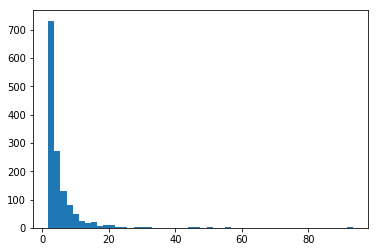

In [54]:
sizes = [k.size for k in kp1] + [k.size for k in kp2]
plt.hist(sizes, bins=50);
print(sizes[:6])
print('Mean: {}'.format(np.mean(sizes)))

[1573632, 1573632, 11141634, 9830913, 11469568, 13238529]


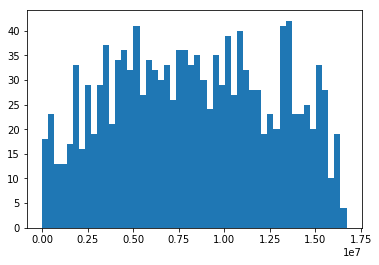

In [50]:
octaves = [k.octave for k in kp1] + [k.octave for k in kp2]
plt.hist(octaves, bins=50);
print(octaves[:6])